### **Object Detection with RCNN and Hybrid Models**

**Project Roadmap: Food-101 Object Detection**

---

**Data Preparation**

- **Annotations: CSV Format**  
  Dataset includes bounding box annotations in CSV format with fields:  
  `filename, width, height, class, xmin, ymin, xmax, ymax`

- **Convert CSV → YOLO Format**  
  Required for training with YOLOv5/YOLOv8 using the Ultralytics framework.

- **Create Label Map / Encoder**  
  - `LabelEncoder` is used in the PyTorch-based pipeline for Faster R-CNN.  
  - Maps text labels to numeric class IDs for consistent training and evaluation across both models.

---

**Model Training**

- **Train Faster R-CNN (PyTorch)**  
  - Implemented using PyTorch and `torchvision`'s Faster R-CNN.  
  - Includes custom dataset class, Albumentations-based transforms, and a full training loop.  
  - Optionally integrates EfficientNet or other backbones for feature extraction.

- **Train YOLOv5 / YOLOv8 (Ultralytics)**  
  - Uses YOLO-compatible folder structure and annotation format.  
  - Training is performed using the `yolo train` command with a custom configuration and dataset.

---

**Evaluation & Comparison**

- **Evaluate on Custom Test Set**  
  Run inference on a manually curated test set using both trained models.

- **Metrics to Compare:**
  - mean Average Precision (mAP)  
  - Inference time per image  
  - Confusion matrix  
  - Sample visual predictions (bounding boxes over test images)

---

**Report Findings**

- **Visual Comparison**  
  Display side-by-side bounding box predictions from Faster R-CNN and YOLO models.

- **Deployment Considerations:**
  - Accuracy vs. Speed trade-off  
  - Resource usage (GPU vs. CPU)  
  - Ease of integration (e.g., TorchScript or ONNX export)

---


#### **Faster R-CNN**

**Introduction to Faster R-CNN**

Faster R-CNN (Region-based Convolutional Neural Network) is a state-of-the-art, two-stage object detection framework developed by Ren et al. in 2015. It significantly improves upon earlier R-CNN and Fast R-CNN models by introducing an efficient region proposal mechanism.

Faster R-CNN operates in two main stages:

1. **Region Proposal Network (RPN):**
   - Quickly scans the image using a sliding window and proposes candidate object bounding boxes.
   - This stage is fully convolutional and shares features with the detection network, making it much faster than external proposal methods like Selective Search.

2. **Object Detection Network:**
   - For each proposed region, features are extracted and passed to a classifier and bounding box regressor.
   - The classifier predicts the object class, and the regressor refines the bounding box coordinates.

**Why use Faster R-CNN?**
- High detection accuracy, especially for small or overlapping objects.
- Widely adopted in research and real-world applications.
- Flexible: Backbone architectures like ResNet, VGG, or EfficientNet can be used for feature extraction.

**In PyTorch:**
- PyTorch provides a prebuilt Faster R-CNN implementation via `torchvision.models.detection`.
- It supports custom datasets by implementing a simple `Dataset` class returning images and target dictionaries.
- No need for special formats like TFRecord or Pascal VOC — you can use annotations from CSV or JSON.

This makes Faster R-CNN a powerful and accessible model for training custom object detectors, like identifying food items in the Food-101 dataset.



**Prepare Annotations (CSV for PyTorch Faster R-CNN)**

- Use bounding box annotations directly from CSV.  
- Implement a custom PyTorch `Dataset` class that returns image and corresponding target dictionary (`boxes`, `labels`, etc.).
- No need to convert to Pascal VOC XML or TFRecord formats (required only for TensorFlow-based pipelines).


#### **Install Required Packages**

In [ ]:
# python3 -m venv .venv_food_od
# source .venv_food_od/bin/activate

# pip install --upgrade pip setuptools wheel
# pip install torch torchvision matplotlib pandas scikit-learn
!pip install pycocotools



  Using cached pycocotools-2.0.10-cp39-cp39-macosx_10_9_universal2.whl.metadata (1.3 kB)
Using cached pycocotools-2.0.10-cp39-cp39-macosx_10_9_universal2.whl (153 kB)


In [ ]:
!pip install -U albumentations

  Using cached PyYAML-6.0.2-cp39-cp39-macosx_11_0_arm64.whl.metadata (2.1 kB)
  Using cached annotated_types-0.7.0-py3-none-any.whl.metadata (15 kB)
  Using cached typing_inspection-0.4.1-py3-none-any.whl.metadata (2.6 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 25.8 MB/s eta 0:00:00
Using cached annotated_types-0.7.0-py3-none-any.whl (13 kB)
Using cached typing_inspection-0.4.1-py3-none-any.whl (14 kB)
Using cached PyYAML-6.0.2-cp39-cp39-macosx_11_0_arm64.whl (172 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10/10 [albumentations]m [albucore]


#### **Imports and Utilities**

In [82]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import pandas as pd
from collections import defaultdict
import torchvision
from tqdm import tqdm
import os
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import Dataset
import numpy as np
from PIL import Image
import torchvision.transforms.functional as F
import time
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import DataLoader
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2

In [2]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


#### **Helper Functions**

In [104]:
def get_food101_model(num_classes):

    # Load a pre-trained Faster R-CNN model with a ResNet-50 backbone and Feature Pyramid Network (FPN)
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    # Get the number of input features for the classifier head
    in_features = model.roi_heads.box_predictor.cls_score.in_features

    # Replace the pre-trained classifier with a new one for our specific number of classes
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model

def train_faster_rcnn_food101(model, train_loader, device, epochs=10):
    model.to(device)
    model.train()
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)

    total_start_time = time.time()  # Start total timer

    for epoch in range(epochs):
        start_time = time.time()
        running_loss = 0.0
        progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}", leave=True)

        for i, (imgs, targets) in enumerate(progress_bar):
            imgs = [img.to(device) for img in imgs]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(imgs, targets)
            losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            running_loss += losses.item()
            avg_loss = running_loss / (i + 1)
            progress_bar.set_postfix(loss=losses.item(), avg_loss=avg_loss)

        end_time = time.time()
        epoch_duration = end_time - start_time
        minutes, seconds = divmod(epoch_duration, 60)
        print(f"Epoch {epoch+1}: Final Avg Loss = {avg_loss:.4f} | Time: {int(minutes)}m {int(seconds)}s")

    total_end_time = time.time()
    total_duration = total_end_time - total_start_time
    total_minutes, total_seconds = divmod(total_duration, 60)
    print(f"\n✅ Total Training Time: {int(total_minutes)}m {int(total_seconds)}s")

def load_annotations_from_csv(df, image_dir):
    annotations = defaultdict(list)
    for _, row in df.iterrows():
        image_path = f"{image_dir}/{row['filename']}"
        box = [int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax'])]
        label = row['class']
        annotations[image_path].append(box + [label])  # [x1, y1, x2, y2, label]

    return annotations

def get_class_mapping(csv_path):
    df = pd.read_csv(csv_path)
    class_names = sorted(df['class'].unique().tolist())
    return {name: idx + 1 for idx, name in enumerate(class_names)}  # background is 0



def decode_labels(label_encoder):
    """Returns a mapping from class index to class name."""
    return {idx: name for idx, name in enumerate(label_encoder.classes_)}

def filter_predictions(predictions, label_mapper, threshold=0.5):
    """Filters predictions by score and maps label indices to names."""
    filtered = []
    for box, label, score in zip(predictions['boxes'], predictions['labels'], predictions['scores']):
        if score >= threshold:
            filtered.append({
                "bbox": box.cpu().numpy().tolist(),
                "label": label_mapper[int(label)],
                "score": round(float(score), 2)
            })
    return filtered

def extract_ground_truths(target, label_mapper):
    """Extracts ground truth boxes and labels."""
    boxes = target['boxes'].cpu().numpy()
    labels = target['labels'].cpu().numpy()
    return [box.tolist() + [label_mapper[int(lbl)]] for box, lbl in zip(boxes, labels)]

def evaluate_faster_rcnn_on_dataset(model, dataset, label_encoder, device, confidence_threshold=0.5):
    """
    Runs inference using Faster R-CNN on a dataset and returns predictions + ground truths.

    Args:
        model: Trained Faster R-CNN model
        dataset: PyTorch dataset with image_paths and __getitem__ returning (image_tensor, target_dict)
        label_encoder: Fitted sklearn LabelEncoder
        device: 'cuda' or 'cpu'
        confidence_threshold: Minimum confidence for keeping predictions

    Returns:
        List of dicts with image path, predictions, and ground truths
    """
    model.eval()
    label_mapper = decode_labels(label_encoder)
    results = []

    for idx in tqdm(range(len(dataset)), desc="Running Faster R-CNN Inference"):
        image_path = dataset.image_paths[idx]

        try:
            image, target = dataset[idx]
            if image is None or target is None:
                continue
        except Exception as e:
            print(f"[Warning] Failed to load image or target at index {idx}: {e}")
            continue

        image = image.to(device).unsqueeze(0)  # Add batch dimension

        with torch.no_grad():
            outputs = model(image)[0]  # Take the first item in batch

        predictions = filter_predictions(outputs, label_mapper, confidence_threshold)
        ground_truths = extract_ground_truths(target, label_mapper)

        results.append({
            "image_path": image_path,
            "predictions": predictions,
            "ground_truths": ground_truths
        })

    return results

def draw_boxes(ax, boxes, color, label_prefix="", is_pred=False, threshold=0.5):
    """
    Draws bounding boxes on the axis.

    Args:
        ax: Matplotlib axis
        boxes: list of predictions or ground truths
        color: box color
        label_prefix: 'Actual' or 'Predicted'
        is_pred: True for predictions (score will be shown)
        threshold: min confidence score for predictions
    """
    for box in boxes:
        if is_pred:
            score = box.get("score", 0)
            if score < threshold:
                continue
            x1, y1, x2, y2 = box["bbox"]
            label = f'{label_prefix}: {box["label"]} ({score:.2f})'
        else:
            x1, y1, x2, y2, cls = box
            label = f'{label_prefix}: {cls}'

        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                 linewidth=2, edgecolor=color, facecolor='none')
        ax.add_patch(rect)
        ax.text(x1, y1 - 5, label, fontsize=8, color=color,
                bbox=dict(facecolor='white', edgecolor=color, boxstyle='round,pad=0.2'))

def visualize_multiple_images(image_data_list, threshold=0.5, cols=3, save_path=None):
    """
    Visualizes predictions and ground truths for multiple images.

    Args:
        image_data_list: list of dicts with keys:
                         'image_path', 'predictions', 'ground_truths'
        threshold: float - prediction confidence threshold
        cols: number of columns in subplot grid
        save_path: optional path to save the figure
    """
    num_images = len(image_data_list)
    rows = (num_images + cols - 1) // cols
    fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
    axs = axs.flatten()

    for idx in range(rows * cols):
        ax = axs[idx]
        if idx >= num_images:
            ax.axis('off')
            continue

        item = image_data_list[idx]
        image_path = item.get('image_path')
        predictions = item.get('predictions', [])
        ground_truths = item.get('ground_truths', [])

        try:
            img = Image.open(image_path).convert("RGB")
            ax.imshow(img)
        except:
            ax.set_title("Image Load Failed")
            ax.axis('off')
            continue

        draw_boxes(ax, ground_truths, color='green', label_prefix='Actual', is_pred=False)
        draw_boxes(ax, predictions, color='red', label_prefix='Predicted', is_pred=True, threshold=threshold)

        ax.axis('off')

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        print(f"Saved visualization to {save_path}")

    plt.show()

def draw_sample(image, target, class_names):
    image = image.permute(1, 2, 0).numpy()  # CHW → HWC
    image = (image * 255).clip(0, 255).astype(np.uint8).copy()

    for box, label in zip(target['boxes'], target['labels']):
        x_min, y_min, x_max, y_max = [int(coord) for coord in box]
        class_name = class_names[label.item()]
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 255), 2)
        cv2.putText(image, class_name, (x_min, max(0, y_min - 10)), cv2.FONT_HERSHEY_SIMPLEX,
                    0.9, (255, 255, 0), 1, cv2.LINE_AA)
    return image

def show_grid(dataset, class_names, num_images=10, images_per_row=5):
    num_rows = (num_images + images_per_row - 1) // images_per_row
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(images_per_row * 4, num_rows * 4))

    for idx in range(num_images):
        sample = dataset[idx]
        image = draw_sample(*sample, class_names)

        row = idx // images_per_row
        col = idx % images_per_row
        ax = axes[row, col] if num_rows > 1 else axes[col]
        ax.imshow(image)
        ax.axis('off')

    # Hide unused axes
    total_slots = num_rows * images_per_row
    for idx in range(num_images, total_slots):
        row = idx // images_per_row
        col = idx % images_per_row
        ax = axes[row, col] if num_rows > 1 else axes[col]
        ax.axis('off')

    plt.tight_layout()
    plt.show()

import numpy as np
from collections import defaultdict


def compute_iou(boxA, boxB):
    """
    Compute the Intersection over Union (IoU) of two bounding boxes.
    """
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA) * max(0, yB - yA)

    if interArea == 0:
        return 0.0

    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

def evaluate_detections(image_data_list, iou_threshold=0.5):
    """
    Evaluate predictions vs ground truths.

    Args:
        image_data_list: List of dicts with keys:
                         'predictions', 'ground_truths'
        iou_threshold: Minimum IoU to consider prediction correct

    Returns:
        dict with precision, recall, f1, mAP
    """
    tp, fp, fn = 0, 0, 0
    all_aps = []

    for item in image_data_list:
        preds = item['predictions']
        gts = item['ground_truths']

        matched_gt = set()
        matched_pred = set()

        gt_boxes = [gt[:4] for gt in gts]
        gt_labels = [gt[4] for gt in gts]

        for pred_idx, pred in enumerate(preds):
            pred_box = pred['bbox']
            pred_label = pred['label']
            max_iou = 0
            match_gt_idx = -1

            for gt_idx, (gt_box, gt_label) in enumerate(zip(gt_boxes, gt_labels)):
                if gt_idx in matched_gt:
                    continue
                if pred_label != gt_label:
                    continue

                iou = compute_iou(pred_box, gt_box)
                if iou > max_iou:
                    max_iou = iou
                    match_gt_idx = gt_idx

            if max_iou >= iou_threshold:
                tp += 1
                matched_gt.add(match_gt_idx)
                matched_pred.add(pred_idx)
            else:
                fp += 1

        fn += len(gt_boxes) - len(matched_gt)

    # Compute final metrics
    precision = tp / (tp + fp) if tp + fp > 0 else 0.0
    recall = tp / (tp + fn) if tp + fn > 0 else 0.0
    f1 = 2 * precision * recall / (precision + recall) if precision + recall > 0 else 0.0

    results = {
        'True Positives': tp,
        'False Positives': fp,
        'False Negatives': fn,
        'Precision': round(precision, 4),
        'Recall': round(recall, 4),
        'F1 Score': round(f1, 4)
    }

    return results

def compute_ap(recalls, precisions):
    """
    Compute Average Precision using 11-point interpolation.
    """
    ap = 0.0
    for t in np.linspace(0, 1, 11):
        prec_at_recall = [p for r, p in zip(recalls, precisions) if r >= t]
        ap += max(prec_at_recall) if prec_at_recall else 0
    return ap / 11

def compute_per_class_ap(image_data_list, iou_thresholds=np.arange(0.5, 1.0, 0.05)):
    """
    Compute per-class Average Precision (AP) and mean Average Precision (mAP) across IoU thresholds.
    """
    all_classes = set()
    for item in image_data_list:
        for gt in item['ground_truths']:
            all_classes.add(gt[4])
        for pred in item['predictions']:
            all_classes.add(pred['label'])

    class_ap_results = defaultdict(dict)

    for cls in sorted(all_classes):
        for iou_thresh in iou_thresholds:
            tp = []
            fp = []
            scores = []
            n_positives = 0

            for item in image_data_list:
                gt_boxes = [gt[:4] for gt in item['ground_truths'] if gt[4] == cls]
                pred_boxes = [pred['bbox'] for pred in item['predictions'] if pred['label'] == cls]
                pred_scores = [pred['score'] for pred in item['predictions'] if pred['label'] == cls]

                matched_gt = set()
                n_positives += len(gt_boxes)

                for pred_box, score in zip(pred_boxes, pred_scores):
                    best_iou = 0.0
                    best_gt_idx = -1
                    for idx, gt_box in enumerate(gt_boxes):
                        iou = compute_iou(pred_box, gt_box)
                        if iou > best_iou:
                            best_iou = iou
                            best_gt_idx = idx

                    if best_iou >= iou_thresh and best_gt_idx not in matched_gt:
                        tp.append(1)
                        fp.append(0)
                        matched_gt.add(best_gt_idx)
                    else:
                        tp.append(0)
                        fp.append(1)
                    scores.append(score)

            if n_positives == 0:
                class_ap_results[cls][f"AP@{iou_thresh:.2f}"] = None
                continue

            if len(tp) == 0:
                class_ap_results[cls][f"AP@{iou_thresh:.2f}"] = 0.0
                continue

            # Sort by descending score
            indices = np.argsort(scores)[::-1]
            tp = np.array(tp)[indices]
            fp = np.array(fp)[indices]

            # Cumulative sums
            tp_cum = np.cumsum(tp)
            fp_cum = np.cumsum(fp)
            recalls = tp_cum / n_positives
            precisions = tp_cum / (tp_cum + fp_cum + 1e-6)

            ap = compute_ap(recalls, precisions)
            class_ap_results[cls][f"AP@{iou_thresh:.2f}"] = round(ap, 4)

    # Add mAP per class and overall
    mAP_total = 0
    valid_class_count = 0
    for cls in class_ap_results:
        valid_aps = [v for k, v in class_ap_results[cls].items() if v is not None]
        if valid_aps:
            class_ap_results[cls]['mAP@[.5:.95]'] = round(np.mean(valid_aps), 4)
            mAP_total += class_ap_results[cls]['mAP@[.5:.95]']
            valid_class_count += 1
        else:
            class_ap_results[cls]['mAP@[.5:.95]'] = None

    class_ap_results['mean_mAP@[.5:.95]'] = round(mAP_total / valid_class_count, 4) if valid_class_count > 0 else 0.0
    return dict(class_ap_results)


def display_per_class_ap_table(per_class_ap_results):
    print(f"{'Class':<15}{'AP@0.50':<10}{'AP@0.75':<10}{'mAP@[.5:.95]'}")
    print("-" * 50)

    total_map = 0
    class_count = 0

    for cls, metrics in per_class_ap_results.items():
        if cls == 'mean_mAP@[.5:.95]':
            continue

        ap_50 = metrics.get('AP@0.50', 0.0)
        ap_75 = metrics.get('AP@0.75', 0.0)
        mAP = metrics.get('mAP@[.5:.95]', 0.0)

        print(f"{cls:<15}{ap_50:<10.4f}{ap_75:<10.4f}{mAP:.4f}")
        total_map += mAP
        class_count += 1

    mean_map = per_class_ap_results.get('mean_mAP@[.5:.95]', total_map / max(1, class_count))
    print("-" * 50)
    print(f"{'Mean mAP':<35}{mean_map:.4f}")




#### **Prepare Data**

In [103]:
# Path to the CSV file containing image annotations (e.g., bounding boxes, labels)
csv_path = '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images/_annotations.csv'

# Path to the folder where the original images are stored
image_dir_path = '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images'


##### **Split the CSV into Train/Test**

In [11]:
# Load your original CSV
df = pd.read_csv(csv_path)

# Split 80% train, 20% test
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Create directory if it doesn't exist
os.makedirs('data', exist_ok=True)

# Save new CSVs
train_df.to_csv('/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/food101_train.csv', index=False)
test_df.to_csv('/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/food101_test.csv', index=False)

print("CSV split complete.")


CSV split complete.


##### **PyTorch Dataset for Object Detection**

In [5]:
# Custom PyTorch Dataset for the Food-101 object detection task using Faster R-CNN.
class Food101FasterRCNNDataset(Dataset):
    def __init__(self, annotations, label_encoder, transform=None):
        """
        Custom PyTorch Dataset for the Food-101 object detection task using Faster R-CNN.

        Args:
            annotations (dict): Dictionary where keys are image paths and values are lists of bounding boxes and labels.
            label_encoder (LabelEncoder): Encoder to convert string labels to numeric class IDs.
            transform (callable, optional): Albumentations transform pipeline.
        """
        self.image_paths = list(annotations.keys())
        self.annotations = annotations
        self.label_encoder = label_encoder
        self.transform = transform

    def __getitem__(self, idx):
        """
        Load and return a single sample (image and target dictionary) for Faster R-CNN.

        Args:
            idx (int): Index of the sample.

        Returns:
            tuple: (transformed_image_tensor, target_dict)
        """
        # Load image using PIL and convert to RGB
        image_path = self.image_paths[idx]
        image = np.array(Image.open(image_path).convert("RGB"))

        # Retrieve bounding boxes and class labels for the image
        annots = self.annotations[image_path]
        boxes = []
        labels = []

        for x1, y1, x2, y2, label in annots:
            boxes.append([x1, y1, x2, y2])
            # Encode label to integer
            labels.append(self.label_encoder.transform([label])[0])

        # Apply Albumentations transformations (with bounding box support)
        if self.transform:
            transformed = self.transform(image=image, bboxes=boxes, labels=labels)
            image = transformed['image']             # Transformed image tensor
            boxes = transformed['bboxes']            # Transformed bounding boxes
            labels = transformed['labels']           # Transformed labels
        else:
            # Default transform: convert image to tensor
            image = F.to_tensor(image)

        # Prepare target dictionary as required by torchvision Faster R-CNN
        target = {
            "boxes": torch.tensor(boxes, dtype=torch.float32),     # Bounding boxes
            "labels": torch.tensor(labels, dtype=torch.int64)      # Class labels
        }

        return image, target

    def __len__(self):
        """
        Total number of samples in the dataset.
        """
        return len(self.image_paths)


In [6]:
# Define file paths for the training and testing CSV annotation files
food101_train_csv = '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/food101_train.csv'
food101_test_csv = '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/food101_test.csv'

# Load the training and test annotations into pandas DataFrames
# Each CSV is expected to contain columns such as: filename, width, height, class, xmin, ymin, xmax, ymax
train_df = pd.read_csv(food101_train_csv)
test_df = pd.read_csv(food101_test_csv)


In [7]:
# Display the contents of the training DataFrame
# This shows the first few rows of the annotation data (image filename, dimensions, class, bounding box coordinates)
train_df


,filename,width,height,class,xmin,ymin,xmax,ymax
0,74573_jpg.rf.dcef5d89023ceb7b0f30e0bc10bb98e1.jpg,512,512,tacos,18,52,501,371
1,2902847_jpg.rf.5af2b9f63074be63f06affec03129ad...,512,384,Apple Pie,0,1,511,313
2,1015285_jpg.rf.e7356b427704c6068a72de1c36c96a2...,512,512,tacos,52,87,241,350
3,101450_jpg.rf.eddcc68593aa541ba3d9cce8835094be...,512,512,pancakes,227,128,355,180
4,49803_jpg.rf.9167fefe88ed97b0e29b40cf55e69a83.jpg,512,512,tacos,11,13,507,497
...,...,...,...,...,...,...,...,...
441,166821_jpg.rf.2b4360a4122ab2bcc7e6fd25c876c33c...,512,382,French Fries,0,76,499,381
442,93653_jpg.rf.c6cc96b4d0e56222c18ce6e05eafd9a8.jpg,512,383,French Fries,0,37,468,359
443,77677_jpg.rf.f324b9cabce168e28640ec343ab6f0e5.jpg,640,640,Pizza,5,0,640,640
444,2462689_jpg.rf.c984e63ea135d72a33d445e17181242...,512,512,spring_rolls,192,92,506,462


##### **Data Augmentation Pipeline using Albumentations for Object Detection**

In [8]:
# -----------------------------
# Data Augmentation Pipeline using Albumentations for Object Detection
# -----------------------------
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Define the augmentation pipeline
transform = A.Compose([
    A.HorizontalFlip(p=0.5),  # Randomly flip the image horizontally with 50% probability
    A.RandomBrightnessContrast(p=0.2),  # Adjust brightness and contrast randomly with 20% probability
    A.ColorJitter(p=0.3),  # Apply random changes in brightness, contrast, saturation, and hue with 30% probability
    A.Rotate(limit=15, p=0.4),  # Rotate the image randomly within a 15-degree limit with 40% probability
    A.MotionBlur(p=0.2),  # Apply motion blur with 20% probability
    A.RandomSizedBBoxSafeCrop(height=320, width=320, p=0.5),  # Crop the image to 320x320 ensuring bounding boxes remain valid (50% probability)
    A.Normalize(mean=(0.485, 0.456, 0.406),  # Normalize image using ImageNet mean
                std=(0.229, 0.224, 0.225)),  # and standard deviation
    ToTensorV2()  # Convert image and annotations to PyTorch tensors
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))


##### **Encode Labels and Create Datasets for Faster R-CNN Training (Food-101)**

In [9]:
# ---------------------------------------------
# Encode Labels and Create Datasets for Faster R-CNN Training (Food-101)
# ---------------------------------------------
from sklearn.preprocessing import LabelEncoder

# Encode class labels as integer values
label_encoder = LabelEncoder()
label_encoder.fit(train_df['class'].astype(str))  # Convert class labels to strings and fit the encoder

# Load annotations from CSV for training and testing sets
# This function likely returns a list of dictionaries containing image paths and bounding boxes
train_annotations = load_annotations_from_csv(train_df, image_dir_path)
test_annotations = load_annotations_from_csv(test_df, image_dir_path)

# Create the training dataset using the custom Faster R-CNN dataset class
train_dataset = Food101FasterRCNNDataset(train_annotations, label_encoder)

# Create the testing dataset using the same class and label encoder
test_dataset = Food101FasterRCNNDataset(test_annotations, label_encoder)

In [33]:
train_dataset.annotations

defaultdict(list,
            {'/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images/74573_jpg.rf.dcef5d89023ceb7b0f30e0bc10bb98e1.jpg': [[18,
               52,
               501,
               371,
               'tacos']],
             '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images/2902847_jpg.rf.5af2b9f63074be63f06affec03129ad3.jpg': [[0,
               1,
               511,
               313,
               'Apple Pie']],
             '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images/1015285_jpg.rf.e7356b427704c6068a72de1c36c96a2a.jpg': [[52,
               87,
               241,
               350,
               'tacos']],
             '/content/drive/MyDrive/AI_ML/Python Course/Food101/Datasetv1/original_images/101450_jpg.rf.eddcc68593aa541ba3d9cce8835094be.jpg': [[227,
               128,
               355,
               180,
               'pancakes'],
              [22, 179, 229, 306, '

In [31]:
train_dataset.label_encoder.classes_

array(['Apple Pie', 'Chocolate', 'French Fries', 'Hotdog', 'Nachos',
       'Pizza', 'onion_rings', 'pancakes', 'spring_rolls', 'tacos'],
      dtype=object)

In [10]:
train_dataset.__len__()

414

##### **Visualize One Image per Class**

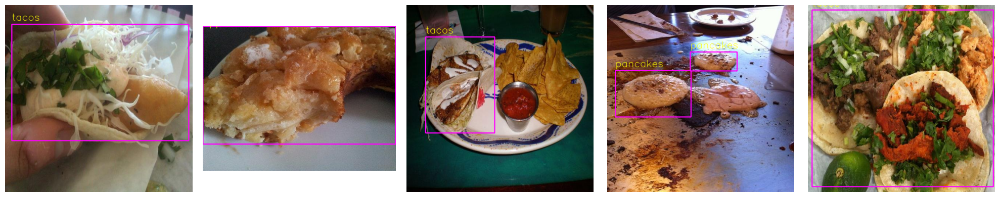

In [84]:
# Display 15 images (5 per row) from train_dataset
show_grid(train_dataset, class_names=label_encoder.classes_, num_images=5, images_per_row=5)

##### **Model Setup: DataLoader, Model Initialization, and Device Configurationr**

In [87]:
# Create a DataLoader for the training dataset
train_loader = DataLoader(
    train_dataset,              # The training dataset (must be a torch.utils.data.Dataset)
    batch_size=1,               # Load one sample at a time (common for Faster R-CNN to handle variable-sized data)
    shuffle=True,               # Shuffle data at every epoch to improve generalization
    collate_fn=lambda x: tuple(zip(*x))  # Custom collate function to correctly batch variable-length targets (e.g., bounding boxes)
)

In [14]:
# Determine the total number of classes (including background)
num_classes = len(label_encoder.classes_) + 1  # Add 1 for the background class, which is required by Faster R-CNN

# Initialize the Faster R-CNN model for Food-101 with the correct number of classes
model = get_food101_model(num_classes)  # Custom function that returns a Faster R-CNN model configured for 'num_classes'


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 161MB/s]


In [16]:
#device = torch.device('mps' if torch.mps.is_available() else 'cpu')

In [15]:
# Select the device to run the model on: use GPU (CUDA) if available, otherwise fallback to CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [17]:
device

device(type='cuda')

##### **Debug and Test: Train on Subset, Verify Training Loop, and Save Model**

In [85]:
# Create a small subset of the training dataset (for quick testing/debugging)
train_subset = torch.utils.data.Subset(train_dataset, range(10))  # Use only the first sample from the training dataset

# Create a DataLoader for the subset
train_loader_subset = DataLoader(
    train_subset,              # Subset containing a small portion of the training data
    batch_size=1,              # Load one sample at a time (suitable for object detection)
    shuffle=True,              # Shuffle the data (not very impactful for a single sample but kept for consistency)
    collate_fn=lambda x: tuple(zip(*x))  # Custom collate function to handle images and their annotations
)


In [86]:
# Train the Faster R-CNN model on a small subset of the Food-101 dataset for 10 epochs (for testing/debugging)
train_faster_rcnn_food101(model, train_loader_subset, device, epochs=10)

Epoch 1: 100%|██████████| 10/10 [00:02<00:00,  4.60it/s, avg_loss=0.155, loss=0.134]


Epoch 1: Final Avg Loss = 0.1550 | Time: 0m 2s


Epoch 2: 100%|██████████| 10/10 [00:02<00:00,  4.71it/s, avg_loss=0.124, loss=0.0977]


Epoch 2: Final Avg Loss = 0.1245 | Time: 0m 2s


Epoch 3: 100%|██████████| 10/10 [00:02<00:00,  4.70it/s, avg_loss=0.0893, loss=0.148]


Epoch 3: Final Avg Loss = 0.0893 | Time: 0m 2s


Epoch 4: 100%|██████████| 10/10 [00:02<00:00,  4.65it/s, avg_loss=0.0726, loss=0.0655]


Epoch 4: Final Avg Loss = 0.0726 | Time: 0m 2s


Epoch 5: 100%|██████████| 10/10 [00:02<00:00,  4.53it/s, avg_loss=0.0804, loss=0.0841]


Epoch 5: Final Avg Loss = 0.0804 | Time: 0m 2s


Epoch 6: 100%|██████████| 10/10 [00:02<00:00,  4.64it/s, avg_loss=0.0757, loss=0.141]


Epoch 6: Final Avg Loss = 0.0757 | Time: 0m 2s


Epoch 7: 100%|██████████| 10/10 [00:02<00:00,  4.68it/s, avg_loss=0.0704, loss=0.0684]


Epoch 7: Final Avg Loss = 0.0704 | Time: 0m 2s


Epoch 8: 100%|██████████| 10/10 [00:02<00:00,  4.65it/s, avg_loss=0.0539, loss=0.0475]


Epoch 8: Final Avg Loss = 0.0539 | Time: 0m 2s


Epoch 9: 100%|██████████| 10/10 [00:02<00:00,  4.64it/s, avg_loss=0.055, loss=0.0543]


Epoch 9: Final Avg Loss = 0.0550 | Time: 0m 2s


Epoch 10: 100%|██████████| 10/10 [00:02<00:00,  4.59it/s, avg_loss=0.0474, loss=0.0502]

Epoch 10: Final Avg Loss = 0.0474 | Time: 0m 2s

✅ Total Training Time: 0m 21s


In [18]:
# Train the Faster R-CNN model on the full Food-101 training set for 10 epochs
train_faster_rcnn_food101(model, train_loader, device, epochs=10)

Epoch 1: 100%|██████████| 414/414 [04:29<00:00,  1.54it/s, avg_loss=0.257, loss=0.145]


Epoch 1: Final Avg Loss = 0.2566 | Time: 4m 29s


Epoch 2: 100%|██████████| 414/414 [01:27<00:00,  4.75it/s, avg_loss=0.217, loss=0.0167]


Epoch 2: Final Avg Loss = 0.2175 | Time: 1m 27s


Epoch 3: 100%|██████████| 414/414 [01:29<00:00,  4.63it/s, avg_loss=0.202, loss=0.217]


Epoch 3: Final Avg Loss = 0.2020 | Time: 1m 29s


Epoch 4: 100%|██████████| 414/414 [01:29<00:00,  4.60it/s, avg_loss=0.199, loss=0.258]


Epoch 4: Final Avg Loss = 0.1991 | Time: 1m 29s


Epoch 5: 100%|██████████| 414/414 [01:29<00:00,  4.61it/s, avg_loss=0.183, loss=0.122]


Epoch 5: Final Avg Loss = 0.1835 | Time: 1m 29s


Epoch 6: 100%|██████████| 414/414 [01:29<00:00,  4.61it/s, avg_loss=0.17, loss=0.221]


Epoch 6: Final Avg Loss = 0.1697 | Time: 1m 29s


Epoch 7: 100%|██████████| 414/414 [01:29<00:00,  4.61it/s, avg_loss=0.178, loss=0.464]


Epoch 7: Final Avg Loss = 0.1778 | Time: 1m 29s


Epoch 8: 100%|██████████| 414/414 [01:30<00:00,  4.59it/s, avg_loss=0.168, loss=0.132]


Epoch 8: Final Avg Loss = 0.1679 | Time: 1m 30s


Epoch 9: 100%|██████████| 414/414 [01:30<00:00,  4.60it/s, avg_loss=0.155, loss=0.0258]


Epoch 9: Final Avg Loss = 0.1551 | Time: 1m 30s


Epoch 10: 100%|██████████| 414/414 [01:30<00:00,  4.59it/s, avg_loss=0.151, loss=0.18]

Epoch 10: Final Avg Loss = 0.1513 | Time: 1m 30s

✅ Total Training Time: 17m 55s


In [22]:
# Save the trained model's weights to the specified path (only the state_dict, not the full model)
torch.save(model.state_dict(), "/content/drive/MyDrive/AI_ML/Python Course/Food101/Model/fasterrcnn_food.pth")

#### **RCNN Model Evaluation**

In [98]:
# Assuming `image_data_list` is output from your get_predictions_faster_rcnn function
results = evaluate_detections(image_data_list, iou_threshold=0.5)

for k, v in results.items():
    print(f"{k}: {v}")


True Positives: 15
False Positives: 107
False Negatives: 97
Precision: 0.123
Recall: 0.1339
F1 Score: 0.1282


In [105]:
per_class_ap_results = compute_per_class_ap(image_data_list)
display_per_class_ap_table(per_class_ap_results)



Class          AP@0.50   AP@0.75   mAP@[.5:.95]
--------------------------------------------------
Apple Pie      0.0000    0.0000    0.0000
Chocolate      0.4015    0.4015    0.2809
French Fries   0.0000    0.0000    0.0000
Hotdog         0.0000    0.0000    0.0000
Nachos         0.0000    0.0000    0.0000
Pizza          0.0000    0.0000    0.0000
onion_rings    0.0000    0.0000    0.0000
pancakes       0.4604    0.0341    0.2010
spring_rolls   0.0000    0.0000    0.0000
tacos          0.0000    0.0000    0.0000
--------------------------------------------------
Mean mAP                           0.0482


##### **Evaluation Summary: Faster R-CNN Object Detection**

**Observation**

**Metrics Overview**
- **True Positives (TP):** 15 — Correct detections.
- **False Positives (FP):** 107 — Predicted objects with no matching ground truth.
- **False Negatives (FN):** 97 — Ground truth objects missed by the model.
- **Precision:** 0.123 — About 12.3% of predictions were correct.
- **Recall:** 0.1339 — About 13.4% of actual objects were detected.
- **F1 Score:** 0.1282 — Low overall detection quality.

---

**Per-Class Average Precision**

| **Class**       | **AP@0.50** | **AP@0.75** | **mAP@[.5:.95]** |
|-----------------|-------------|-------------|------------------|
| Apple Pie       | 0.0000      | 0.0000      | 0.0000           |
| Chocolate       | 0.4015      | 0.4015      | 0.2809           |
| French Fries    | 0.0000      | 0.0000      | 0.0000           |
| Hotdog          | 0.0000      | 0.0000      | 0.0000           |
| Nachos          | 0.0000      | 0.0000      | 0.0000           |
| Pizza           | 0.0000      | 0.0000      | 0.0000           |
| Onion Rings     | 0.0000      | 0.0000      | 0.0000           |
| Pancakes        | 0.4604      | 0.0341      | 0.2010           |
| Spring Rolls    | 0.0000      | 0.0000      | 0.0000           |
| Tacos           | 0.0000      | 0.0000      | 0.0000           |
| **Mean mAP**    |             |             | **0.0482**       |

---

**Observations**
- Very low overall mAP (0.0482), indicating poor detection performance across most classes.
- Only two classes (Chocolate and Pancakes) achieved any non-zero AP scores.
- High number of false positives suggests overprediction or poor confidence calibration.
- Low recall means most ground truth objects were missed.
- Significant drop in AP from IoU=0.5 to IoU=0.75 suggests bounding boxes are not tight.

---

**Suggestions for Improvement**

| **Area**             | **Recommendation**                                                                 |
|----------------------|--------------------------------------------------------------------------------------|
| Data Quality         | Improve dataset balance and labeling accuracy.                                      |
| Data Augmentation    | Use image transformations (flip, crop, brightness, etc.) to improve generalization. |
| Anchor Configuration | Match anchor box shapes and sizes to your object dimensions.                        |
| Backbone Network     | Consider stronger backbones (e.g., ResNet101, EfficientNet) for better features.    |
| Training Strategy    | Increase training duration, tune learning rate, and try multi-scale training.       |
| Model Architecture   | Experiment with alternative detectors like YOLOv5, RetinaNet, or SSD.               |

---

**Next Step**
- Visualize predictions to investigate:
  - Missed detections
  - Localization errors (poorly placed boxes)
  - Misclassified objects


#### **Visualize Model Predictions**

In [69]:
# Create a DataLoader for the test dataset
# Uses batch size of 2 and a custom collate function to properly batch images and annotations
test_loader = DataLoader(test_dataset, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))

In [77]:
# Filter out unreadable or corrupt images from the test DataFrame
test_df_filtered = test_df[
    test_df['filename'].apply(lambda x: cv2.imread(os.path.join(image_dir_path, x)) is not None)
].reset_index(drop=True)

# Set the model to evaluation mode (disables dropout, batchnorm updates, etc.)
model.eval()

# Perform inference on the test dataset and collect predictions
# Applies a confidence threshold of 0.5 to filter out low-confidence detections
image_data_list = evaluate_faster_rcnn_on_dataset(
    model, test_dataset, label_encoder, device, confidence_threshold=0.5
)


Running Faster R-CNN Inference: 100%|██████████| 109/109 [00:10<00:00, 10.52it/s]


In [79]:
# Example result:
from pprint import pprint
pprint(image_data_list[0])

{'ground_truths': [[111.0, 222.0, 386.0, 451.0, 'pancakes']],
 'image_path': '/content/drive/MyDrive/AI_ML/Python '
               'Course/Food101/Datasetv1/original_images/3808342_jpg.rf.7a12a6c4fca5c3f3bed013e2dccd68eb.jpg',
 'predictions': [{'bbox': [127.96453857421875,
                           230.54283142089844,
                           354.22161865234375,
                           433.68359375],
                  'label': 'pancakes',
                  'score': 1.0}]}


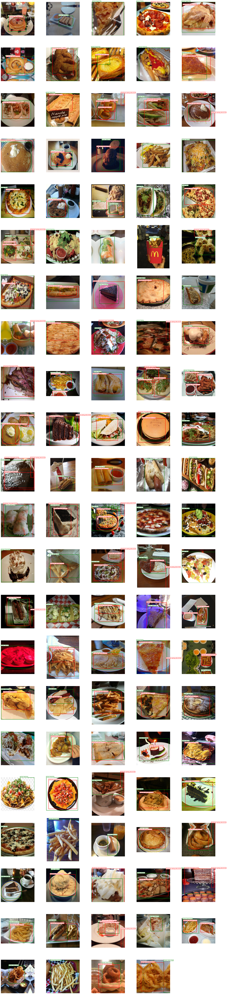

In [80]:
# Visualize multiple test images along with their predicted bounding boxes and labels
# Only display predictions with confidence ≥ 0.5, arranged in a grid with 5 columns
visualize_multiple_images(image_data_list, threshold=0.5, cols=5)
